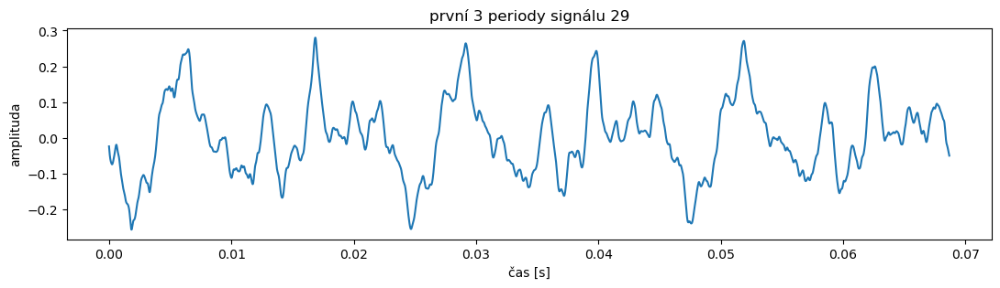

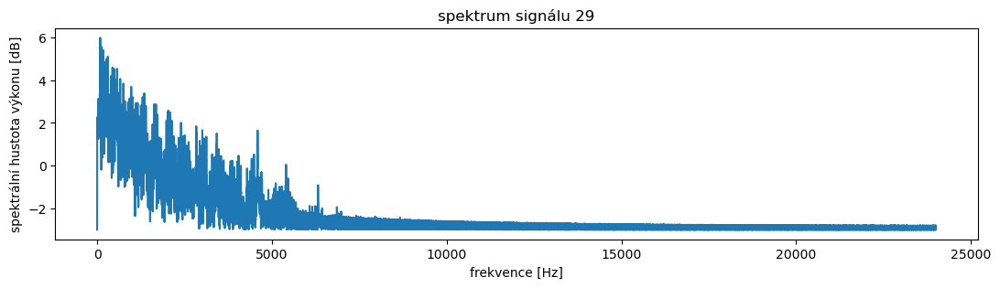

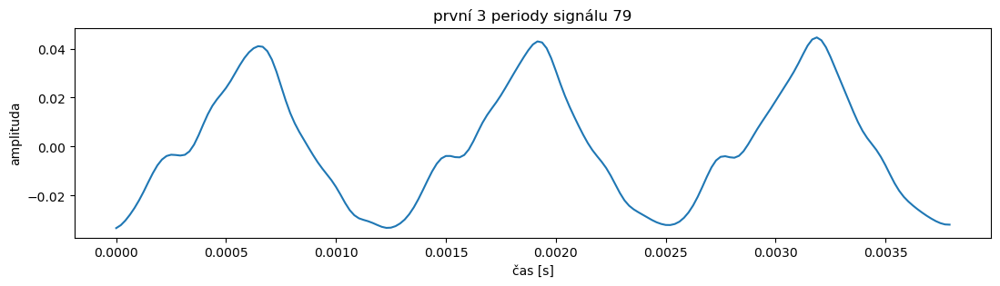

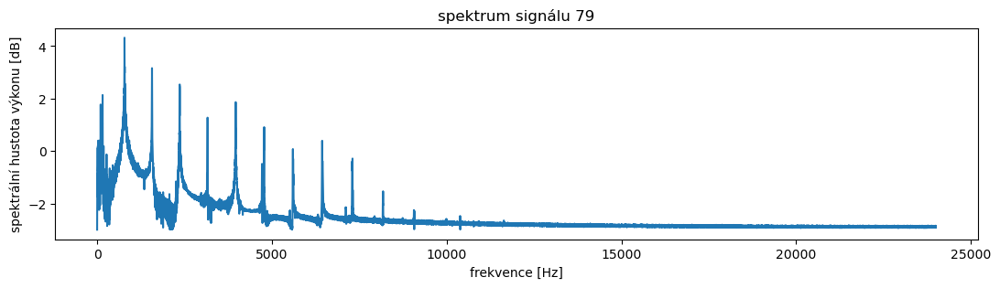

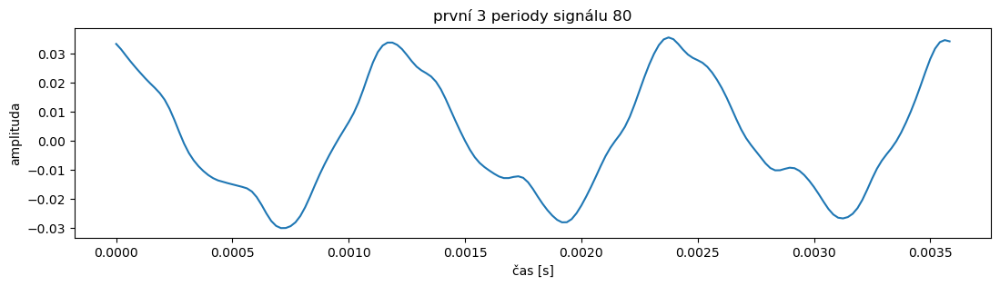

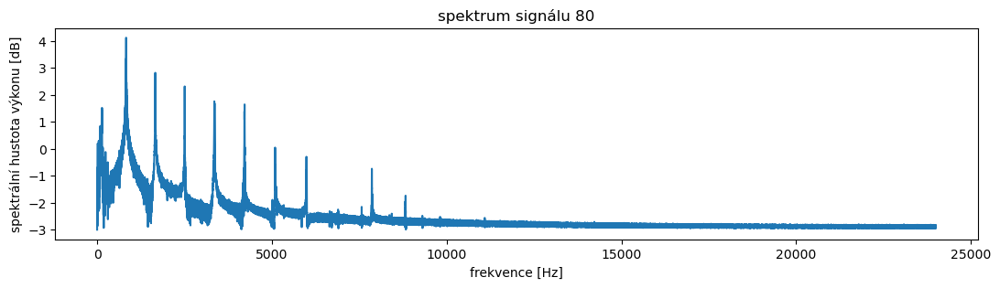

In [1]:
## imports, constants, etc
import numpy as np
import soundfile as sf
import matplotlib.pyplot as plt
import scipy
import scipy.signal
from IPython.display import Audio
from IPython.display import display

TONE_A = 29
TONE_A_F = 43.65
TONE_B = 79
TONE_B_F = 783.99
TONE_C = 80
TONE_C_F = 830.61
MY_TONES = [[TONE_A, TONE_A_F],
            [TONE_B, TONE_B_F],
            [TONE_C, TONE_C_F]]

# import tones
MIDIFROM = 24
MIDITO = 108
SKIP_SEC = 0.25
HOWMUCH_SEC = 0.5
WHOLETONE_SEC = 2
howmanytones = MIDITO - MIDIFROM + 1
tones = np.arange(MIDIFROM, MIDITO + 1)
s, Fs = sf.read('klavir.wav')
N = int(Fs * HOWMUCH_SEC)

Nwholetone = int(Fs * WHOLETONE_SEC)

xall = np.zeros((MIDITO+1, N))  # matrix with all tones - first signals empty,
                                # but we have plenty of memory ...
samplefrom = int(SKIP_SEC * Fs)
sampleto = samplefrom + N
for tone in tones:
    x = s[samplefrom:sampleto]
    x = x - np.mean(x) # safer to center ...
    xall[tone,:] = x
    samplefrom += Nwholetone
    sampleto += Nwholetone

    
### splot tones and spectrums

for tone in MY_TONES:
    # plot tone
    plt.figure(figsize=(13,3))
    plt.title(f'první 3 periody signálu {tone[0]}')
    plt.ylabel('amplituda')
    plt.xlabel('čas [s]')
    time = np.arange(3 * Fs // tone[1])
    time = time / Fs
    plt.plot(time, xall[tone[0]][0:int(3 * Fs // tone[1])])
    
    # do fft with 0 paded signal to get full spectrum
    X = np.fft.fft(np.pad(xall[tone[0]], (0, Fs - N), 'constant', constant_values=0))
    Xmag = np.abs(X[0:N - 1]) # get module

    # plot spectrum
    plt.figure(figsize=(13,3))
    plt.title(f'spektrum signálu {tone[0]}')
    plt.ylabel('spektrální hustota výkonu [dB]')
    plt.xlabel('frekvence [Hz]')
    plt.plot(np.log10(Xmag**2 + 10**-3))
    
    display(Audio(xall[tone[0]], rate=Fs))

midi 24 - 32.780167998360994
midi 25 - 34.72724641875271
midi 26 - 36.79006668199586
midi 27 - 38.97369275738877
midi 28 - 41.286771030448996
midi 29 - 43.735763097949885
midi 30 - 46.33204633204633
midi 31 - 49.08477349422231
midi 32 - 51.99306759098786
midi 33 - 55.08377323846684
midi 34 - 58.358662613981764
midi 35 - 62.1761658031088
midi 36 - 65.75342465753424
midi 37 - 69.76744186046513
midi 38 - 73.47313638450942
midi 39 - 77.84625364904313
midi 40 - 82.47422680412372
midi 41 - 87.65522279035793
midi 42 - 92.87925696594428
midi 43 - 98.4009840098401
midi 44 - 104.23452768729642
midi 45 - 110.42097998619738
midi 46 - 116.98757007068
midi 47 - 124.03100775193798
midi 48 - 131.50684931506848
midi 49 - 139.1304347826087
midi 50 - 146.92378328741967
midi 51 - 155.64202334630352
midi 52 - 164.89178976296805
midi 53 - 176.47058823529412
midi 54 - 186.04651162790697
midi 55 - 198.34710743801654
midi 56 - 210.52631578947367
midi 57 - 222.22222222222223
midi 58 - 235.29411764705884
midi 59

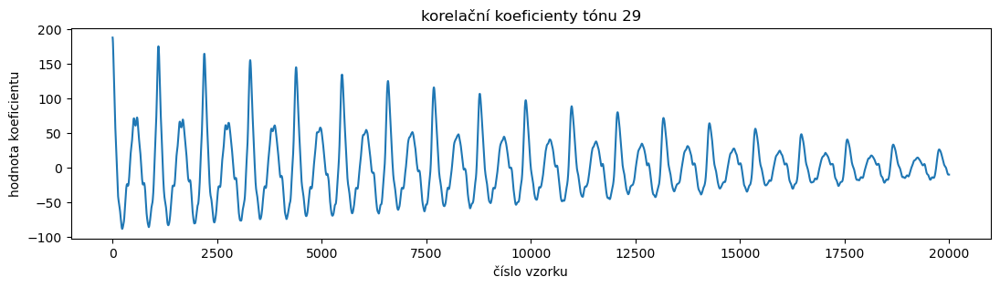

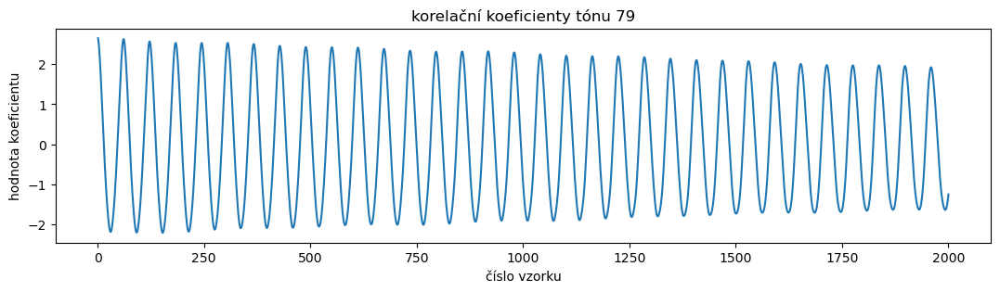

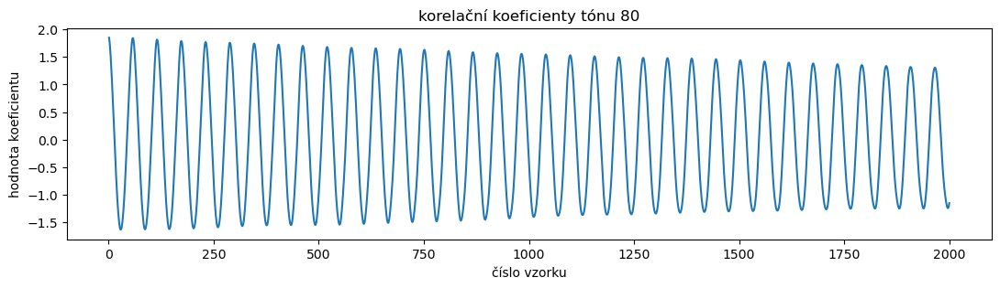

In [2]:
### aproximate midi base frqzs

MIDI_EDGE = (MIDITO - MIDIFROM) // 2 + MIDIFROM

# aray with aproximated values
TONE_MIDI_APROX = np.zeros(MIDITO + 1)

lastmidi = 32 # start value
for i in np.arange(MIDIFROM, MIDI_EDGE):
    corCoef = np.correlate(xall[i], xall[i], mode='full')
    corCoef = corCoef[N:]
    peaks = scipy.signal.find_peaks(corCoef)[0]
    
    lastPeakIdx = 0
    for val in np.arange(10):
        tmpMax = corCoef[peaks[lastPeakIdx + 1]]
        for peak in range(lastPeakIdx + 1, peaks.size):
            if (corCoef[peaks[peak]] > tmpMax):
                lastPeakIdx = peak
                tmpMax = corCoef[peaks[peak]]
        
    sum = Fs / (peaks[lastPeakIdx] / 10)
    # corretion for overflown values
    if (sum > 1.2*lastmidi):
        sum /= 10
    if (sum > 1.2*lastmidi):
        sum /= 2
    
    lastmidi = sum
    TONE_MIDI_APROX[i] = sum

# count of correlated peaks - for higher frqz
for i in np.arange(MIDI_EDGE, MIDITO + 1):
    corCoef = np.correlate(xall[i], xall[i], mode='full') / N
    TONE_MIDI_APROX[i] = scipy.signal.find_peaks(corCoef)[0].size
    
for i in np.arange(MIDIFROM, MIDITO + 1):
    print(f'midi {i} - {TONE_MIDI_APROX[i]}')
        

n = np.arange(-(N-1), N)

corCoef = np.correlate(xall[TONE_A], xall[TONE_A], mode='full')
plt.figure(figsize=(13,3))
plt.title(f'korelační koeficienty tónu {TONE_A}')
plt.xlabel('číslo vzorku')
plt.ylabel('hodnota koeficientu')
plt.plot(n[N:N+20000], corCoef[N:N+20000])


corCoef = np.correlate(xall[TONE_B], xall[TONE_B], mode='full')
plt.figure(figsize=(13,3))
plt.title(f'korelační koeficienty tónu {TONE_B}')
plt.xlabel('číslo vzorku')
plt.ylabel('hodnota koeficientu')
plt.plot(n[N:N + 2000], corCoef[N:N + 2000])


corCoef = np.correlate(xall[TONE_C], xall[TONE_C], mode='full')
plt.figure(figsize=(13,3))
plt.title(f'korelační koeficienty tónu {TONE_C}')
plt.xlabel('číslo vzorku')
plt.ylabel('hodnota koeficientu')
plt.plot(n[N:N + 2000], corCoef[N:N + 2000])

midi 24 - 32.66710267172783
midi 25 - 34.61418109211955
midi 26 - 36.67700135536269
midi 27 - 38.8606274307556
midi 28 - 41.17370570381583
midi 29 - 43.62269777131672
midi 30 - 46.21898100541317
midi 31 - 48.97170816758914
midi 32 - 51.8800022643547
midi 33 - 54.97070791183367
midi 34 - 58.220471659207895
midi 35 - 61.661090426224376
midi 36 - 65.31372616507193
midi 37 - 69.2021152272993
midi 38 - 73.43544794229837
midi 39 - 77.80856520683209
midi 40 - 82.41141273377195
midi 41 - 87.34115243859912
midi 42 - 92.54006098604478
midi 43 - 98.0366624017999
midi 44 - 103.87020607925622
midi 45 - 110.03153275001648
midi 46 - 116.57299720635838
midi 47 - 123.18929920922442
midi 48 - 130.43901011908858
midi 49 - 138.16309809919161
midi 50 - 147.08709987033424
midi 51 - 155.8807168136402
midi 52 - 165.18073448658615
midi 53 - 174.77460833579664
midi 54 - 185.154551828912
midi 55 - 196.1737406038457
midi 56 - 208.1268183020365
midi 57 - 220.50111669458403
midi 58 - 233.59813774756137
midi 59 - 24

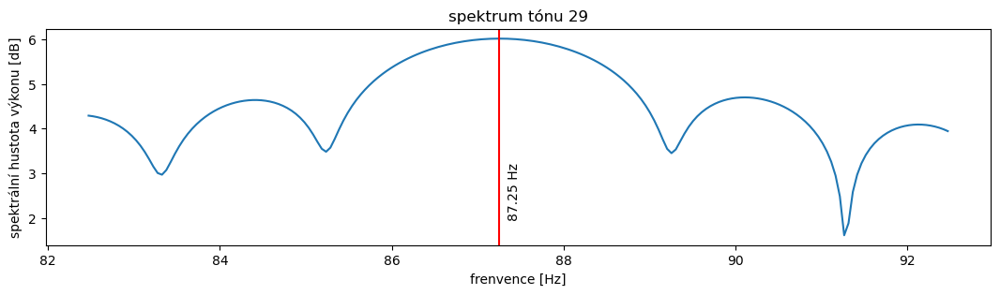

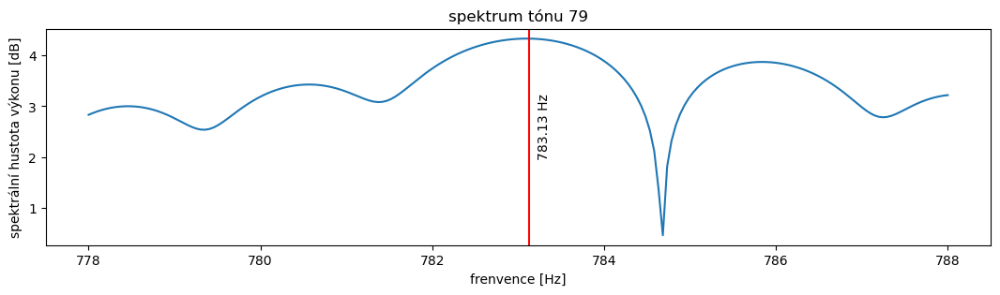

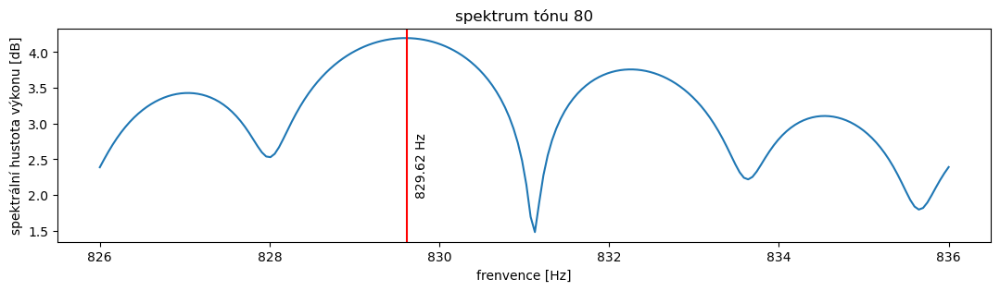

In [3]:
### precisely measure base frqzs

# dtft parametres
DTFTRANGE = 5    # range |-5     aprox      +5| 
DTFTPOINTS = 200 # number of precision points
n = np.arange(0,N)

TONE_MIDI_PRECISE = np.zeros(MIDITO + 1)

for i in np.arange(MIDIFROM, MIDITO + 1):
    # skip first peak - isnt present for lower frqz
    faprox = TONE_MIDI_APROX[i]
    if (i <= MIDI_EDGE):
        faprox *= 2
        
    fsweep = np.linspace(faprox - DTFTRANGE, faprox + DTFTRANGE, DTFTPOINTS)
    
    A = np.zeros([DTFTPOINTS, N], dtype=complex)
    
    for k in np.arange(0,DTFTPOINTS):
        A[k,:] = np.exp(-1j * 2 * np.pi * fsweep[k] / Fs * n)
    
    Xdtft = np.matmul(A,xall[i].T)
    
    precisefmax = fsweep[np.argmax(np.abs(Xdtft))]
    
    # plot my tones
    if (i == TONE_A or i == TONE_B or i == TONE_C):
        plt.figure(figsize=(13,3))
        plt.title(f'spektrum tónu {i}')
        plt.xlabel('frenvence [Hz]')
        plt.ylabel('spektrální hustota výkonu [dB]')
        plt.plot(fsweep, np.log10(np.abs(Xdtft)**2))
        plt.axvline(x = precisefmax, color = 'r')
        plt.text(precisefmax + 0.1, 2, f'{precisefmax.round(2)} Hz', rotation=90)
    
    # correct low freqz
    if (i <= MIDI_EDGE):
        precisefmax /= 2
    TONE_MIDI_PRECISE[i] = precisefmax


for i in np.arange(MIDIFROM, MIDITO + 1):
    print(f'midi {i} - {TONE_MIDI_PRECISE[i]}')

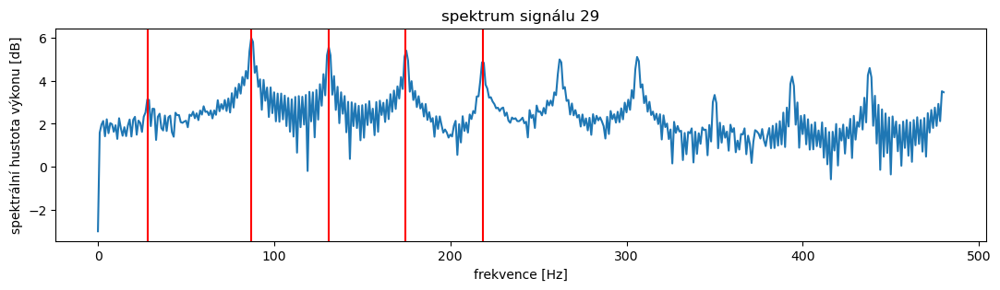

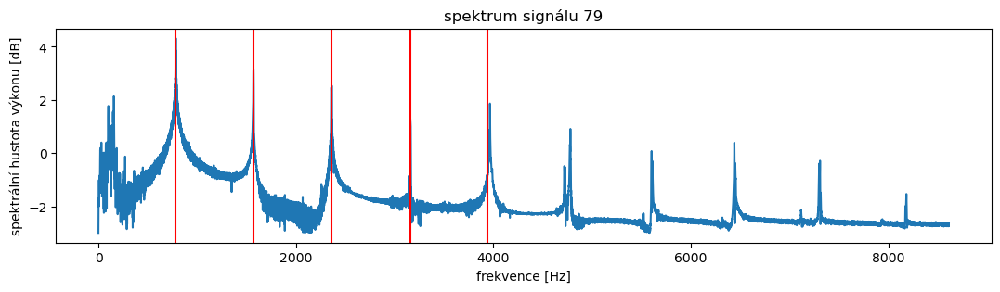

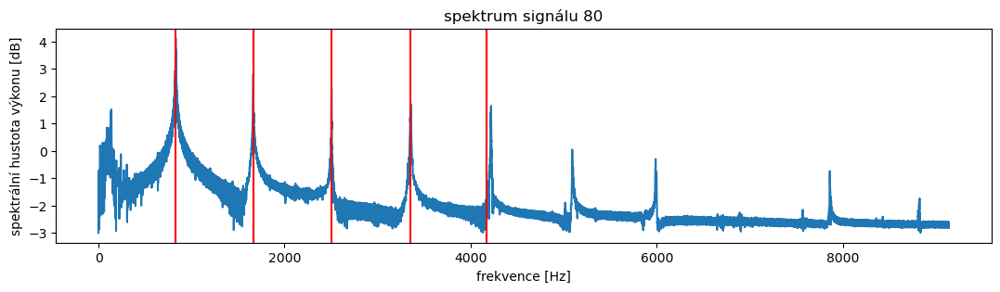

In [4]:
### save each tone in 10 floats (5 complex numbers)

DTFTRANGE = 25
DTFTPOINTS = 100 # number of precision points
n = np.arange(0,N)

# each tone is 5 complex numbers
TONES_MATRIX = np.zeros([MIDITO +1 , 5], dtype=complex)

for i in np.arange(MIDIFROM, MIDITO + 1):
    # plot my tones
    if (i == TONE_A or i == TONE_B or i == TONE_C):
        maxFrqz = round(11 * TONE_MIDI_APROX[i])
        
        # do fft with 0 paded signal to get full spectrum
        X = np.fft.fft(np.pad(xall[i], (0, Fs - N), 'constant', constant_values=0))
        Xmag = np.abs(X[0:N - 1]) # get module
        Xmag = Xmag[:maxFrqz]
        
        
        # plot spectrum
        plt.figure(figsize=(13,3))
        plt.title(f'spektrum signálu {i}')
        plt.ylabel('spektrální hustota výkonu [dB]')
        plt.xlabel('frekvence [Hz]')
        plt.plot(np.log10(Xmag**2 + 10**-3))
    
    for j in np.arange(5):
        # get multpile of base frqz
        faprox = TONE_MIDI_APROX[i] * (j + 1)

        # get array of frqz around
        fsweep = np.linspace(faprox - DTFTRANGE, faprox + DTFTRANGE, DTFTPOINTS)

        A = np.zeros([DTFTPOINTS, N], dtype=complex)

        for k in np.arange(0,DTFTPOINTS):
            A[k,:] = np.exp(-1j * 2 * np.pi * fsweep[k] / Fs * n)

        Xdtft = np.matmul(A,xall[i].T)
        if (i == TONE_A or i == TONE_B or i == TONE_C):
            precisefmax = fsweep[np.argmax(np.abs(Xdtft))]
            plt.axvline(x = precisefmax, color = 'r')

        TONES_MATRIX[i][j] = Xdtft[np.argmax(np.abs(Xdtft))] * 5 / N


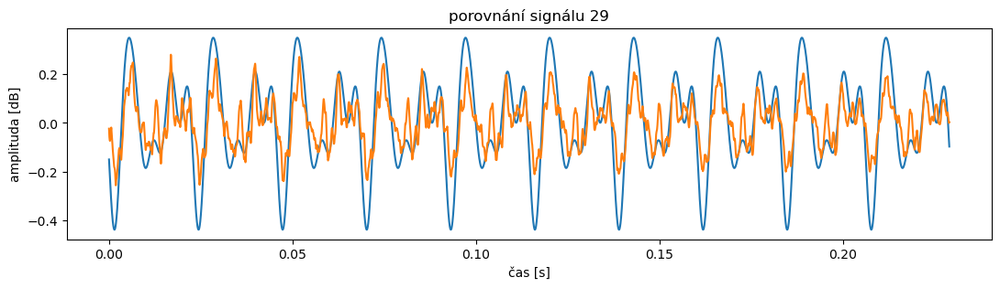

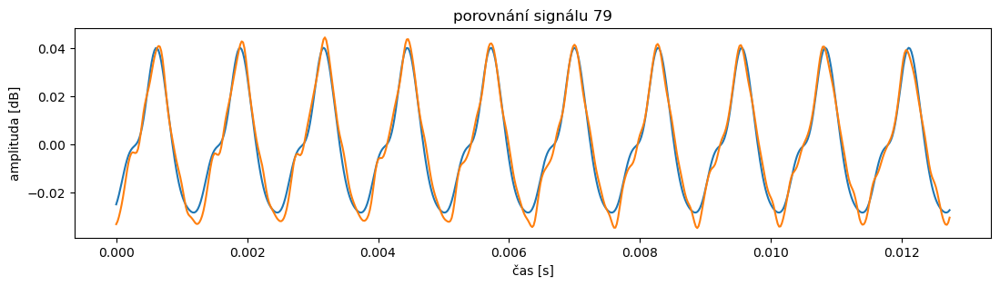

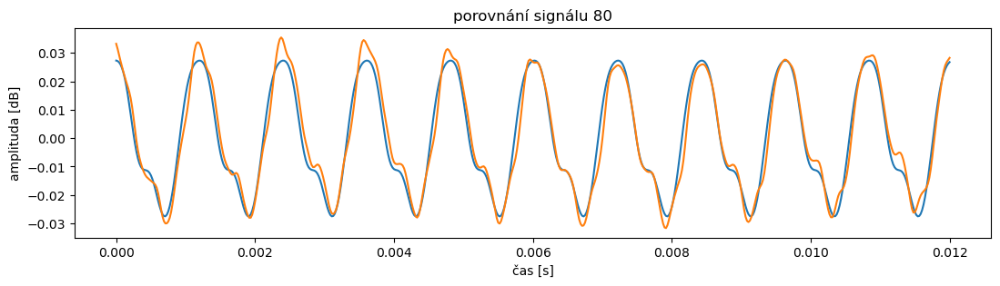

In [5]:
### generate my 3 tones

for tone in MY_TONES:
    MY_TONE = np.zeros(Fs)
    TONE_MIDI = tone[0]
    for i in np.arange(0, Fs):
        for j in np.arange(5):
            #print(f'real - {np.real(TONES_MATRIX[TONE_MIDI][j])} img - {np.imag(TONES_MATRIX[TONE_MIDI][j])}')
            MY_TONE[i] += np.imag(TONES_MATRIX[TONE_MIDI][j]) * np.sin(2 * np.pi * TONE_MIDI_PRECISE[TONE_MIDI] * (j + 1) * (Fs - i) / Fs)
            MY_TONE[i] += np.real(TONES_MATRIX[TONE_MIDI][j]) * np.cos(2 * np.pi * TONE_MIDI_PRECISE[TONE_MIDI] * (j + 1) * (Fs - i) / Fs)


    display(Audio(MY_TONE, rate=Fs))
    display(Audio(xall[TONE_MIDI], rate=Fs))
    
    # shift manually for plotting
    if (tone[0] == TONE_A):
        MY_TONE = np.roll(MY_TONE, -700)
        
    if (tone[0] == TONE_B):
        MY_TONE = np.roll(MY_TONE, -10)
    
    if (tone[0] == TONE_C):
        MY_TONE = np.roll(MY_TONE, -38)

    plt.figure(figsize=(13,3))
    plt.title(f'porovnání signálu {tone[0]}')
    plt.ylabel('amplituda [dB]')
    plt.xlabel('čas [s]')
    time = np.arange(10 * Fs // tone[1])
    time = time / Fs
    plt.plot(time, MY_TONE[0:int(10 * Fs // tone[1])])
    plt.plot(time, xall[tone[0]][0:int(10 * Fs // tone[1])])

In [6]:
### generate 8 kHz

file = open('skladba.txt', 'r')
LINES = file.readlines()
file.close()

song = np.arange(0)
bitrate = 8000
msbitrate = bitrate // 1000

# from | to | MIDI | volume
for line in LINES:
    # get information from line
    content = line.split()
    _from = round(float(content[0]) * msbitrate)
    _to = round(float(content[1]) * msbitrate)
    _midi = int(content[2])
    _volume = int(content[3])
    
    # make sure song array is big enogh
    if (song.size <= _to):
        song = np.append(song, np.zeros(_to - song.size))
    
    for i in np.arange(_from, _to):
        for j in np.arange(5):
            song[i] += _volume * np.imag(TONES_MATRIX[_midi][j]) * np.sin(2 * np.pi * TONE_MIDI_PRECISE[_midi] * (j + 1) * (bitrate - i) / bitrate)
            song[i] += _volume * np.real(TONES_MATRIX[_midi][j]) * np.cos(2 * np.pi * TONE_MIDI_PRECISE[_midi] * (j + 1) * (bitrate - i) / bitrate)
    

display(Audio(song, rate=bitrate))
display(Audio(song[:10 * bitrate], rate=bitrate))

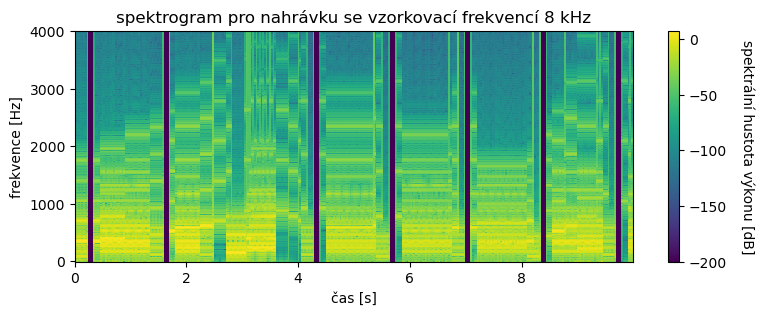

In [7]:
f, t, sgr = scipy.signal.spectrogram(song[:10 * bitrate], fs=bitrate, noverlap=0, nfft=512, nperseg=int(0.03 * bitrate))

# correction for zero values
sgr_log = 10 * np.log10(sgr+1e-20)

plt.figure(figsize=(9,3))
plt.pcolormesh(t,f,sgr_log)
plt.xlabel('čas [s]')
plt.ylabel('frekvence [Hz]')
plt.title('spektrogram pro nahrávku se vzorkovací frekvencí 8 kHz')
cbar = plt.colorbar()
cbar.set_label('spektrální hustota výkonu [dB]', rotation=270, labelpad=20)

In [8]:
### generate 48 kHz

file = open('skladba.txt', 'r')
LINES = file.readlines()
file.close()

song = np.arange(0)
bitrate = 48000
msbitrate = bitrate // 1000

# from | to | MIDI | volume
for line in LINES:
    # get information from line
    content = line.split()
    _from = round(float(content[0]) * msbitrate)
    _to = round(float(content[1]) * msbitrate)
    _midi = int(content[2])
    _volume = int(content[3])
    
    # make sure song array is big enogh
    if (song.size <= _to):
        song = np.append(song, np.zeros(_to - song.size))
    
    for i in np.arange(_from, _to):
        for j in np.arange(5):
            song[i] += _volume * np.imag(TONES_MATRIX[_midi][j]) * np.sin(2 * np.pi * TONE_MIDI_PRECISE[_midi] * (j + 1) * (bitrate - i) / bitrate)
            song[i] += _volume * np.real(TONES_MATRIX[_midi][j]) * np.cos(2 * np.pi * TONE_MIDI_PRECISE[_midi] * (j + 1) * (bitrate - i) / bitrate)
    

display(Audio(song, rate=bitrate))
display(Audio(song[:10 * bitrate], rate=bitrate))

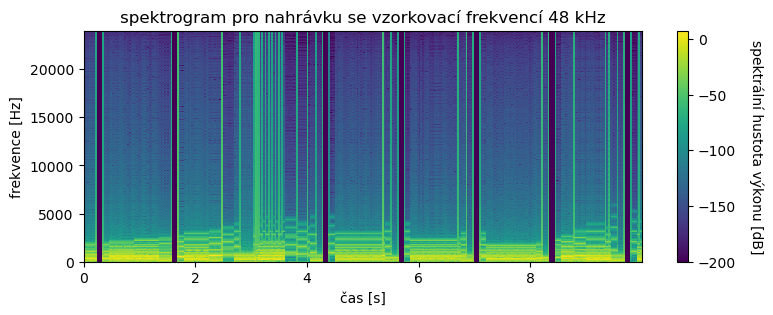

In [9]:
f, t, sgr = scipy.signal.spectrogram(song[:10 * bitrate], fs=bitrate, noverlap=0, nfft=2048, nperseg=int(0.03 * bitrate))

# correction for zero values
sgr_log = 10 * np.log10(sgr+1e-20)

plt.figure(figsize=(9,3))
plt.pcolormesh(t,f,sgr_log)
plt.xlabel('čas [s]')
plt.ylabel('frekvence [Hz]')
plt.title('spektrogram pro nahrávku se vzorkovací frekvencí 48 kHz')
cbar = plt.colorbar()
cbar.set_label('spektrální hustota výkonu [dB]', rotation=270, labelpad=20)